In [21]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import  LogisticRegression
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score, roc_curve, roc_auc_score
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
from ydata_profiling import ProfileReport
import seaborn as sns
import pickle
from sklearn.model_selection import train_test_split
%matplotlib inline

In [40]:
df= pd.read_csv('diabetes.csv')

In [41]:
profile = ProfileReport(df)

In [42]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [52]:
df['BMI']= df['BMI'].replace(0, df['BMI'].mean())
df['Glucose']= df['Glucose'].replace(0, df['Glucose'].mean())
df['BloodPressure']= df['BloodPressure'].replace(0, df['BloodPressure'].mean())
df['SkinThickness']= df['SkinThickness'].replace(0, df['SkinThickness'].mean())
df['Insulin']= df['Insulin'].replace(0, df['Insulin'].mean())

In [60]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [64]:
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:>

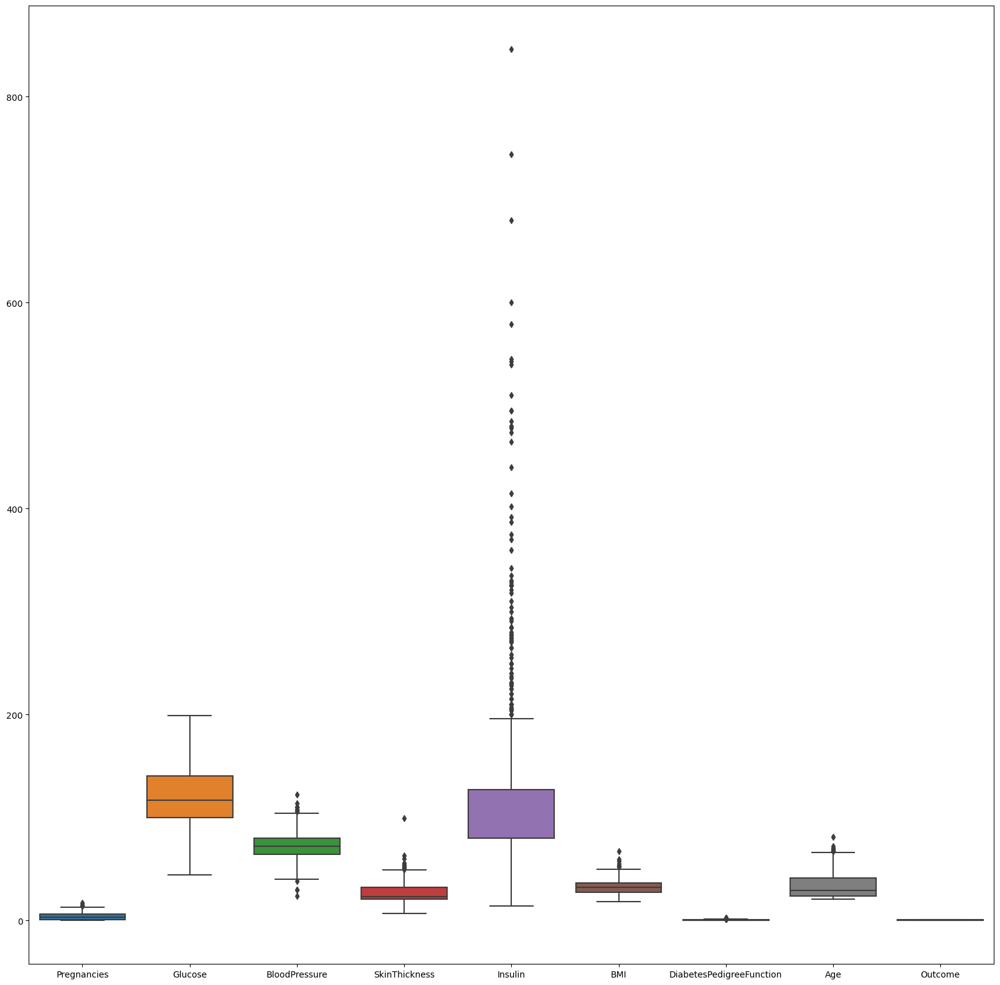

In [53]:
fig ,ax = plt.subplots(figsize = (20,20))
sns.boxplot(data = df, ax = ax)

In [78]:
data = df.copy()

In [140]:
q = data['Pregnancies'].quantile(0.95)
df1 = data[data['Pregnancies']<q]
q = data['Glucose'].quantile(0.95)
df1 = data[data['Glucose']<q]
q = data['BloodPressure'].quantile(0.95)
df1 = data[data['BloodPressure']<q]
q = data['SkinThickness'].quantile(0.95)
df1 = data[data['SkinThickness']<q]
q = data['Insulin'].quantile(0.80)
df1 = data[data['Insulin']<q]
q = data['BMI'].quantile(0.95)
df1 = data[data['BMI']<q]
q = data['DiabetesPedigreeFunction'].quantile(0.95)
df1 = data[data['DiabetesPedigreeFunction']<q]
q = data['Age'].quantile(0.95)
df1 = data[data['Age']<q]

def remove_outlier(self, data):
    def outlier_limit(col):
        
        q1 = data[col].quantile(0.25)
        q3 = data[col].quantile(0.75)
        iqr = q3-q1 #Interquartile range
        LL  = q1-1.5*iqr
        UL = q3+1.5*iqr
        return UL, LL
    for i in data:
        if data[i].dtype!='int64':
            UL,LL = outlier_limit(data[i])
            data = np.where((data[i] > LL) & (data[i] < UL),np.nan,data[i])
    
    return data

In [141]:
df1

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot:>

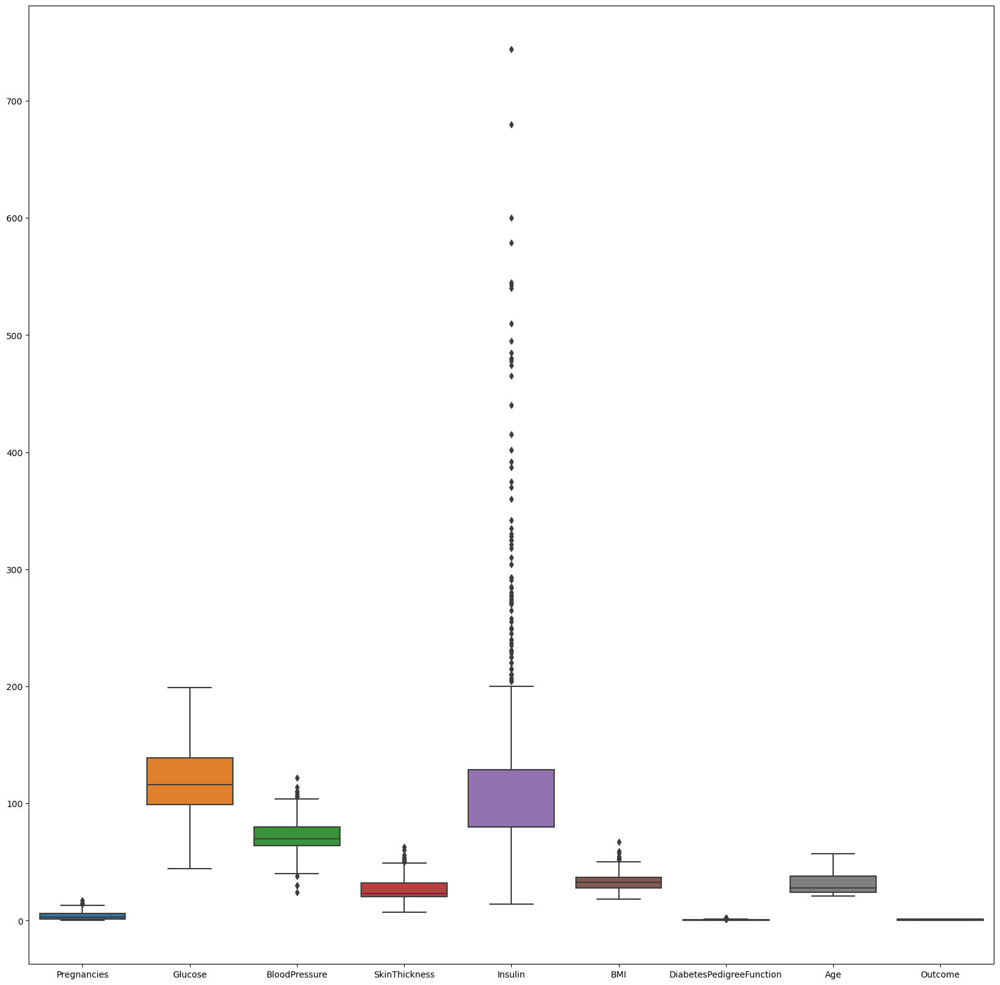

In [142]:
fig ,ax = plt.subplots(figsize = (20,20))
sns.boxplot(data = df1, ax = ax)

In [145]:
x = df1.iloc[:,:-1]
y = df1.iloc[:, -1]

In [146]:
x

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
4,0,137.0,40.0,35.000000,168.000000,43.1,2.288,33
...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [147]:
scalar = StandardScaler()
scalar.fit_transform(x)

array([[ 0.66413742,  0.91333593,  0.0051755 , ...,  0.14404209,
         0.45802677,  1.95415981],
       [-0.82310431, -1.18729019, -0.49124516, ..., -0.8700153 ,
        -0.36378589, -0.05311403],
       [ 1.25903411,  2.08035045, -0.65671871, ..., -1.34807092,
         0.59201797,  0.05253196],
       ...,
       [ 0.36668908,  0.01306759,  0.0051755 , ..., -0.92796143,
        -0.67940959, -0.15876002],
       [-0.82310431,  0.17978395, -0.98766582, ..., -0.36298661,
        -0.36974105,  1.63722183],
       [-0.82310431, -0.92054402, -0.16029805, ..., -0.319527  ,
        -0.47097884, -0.89828196]])

In [148]:
ProfileReport(pd.DataFrame(scalar.fit_transform(x)))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [121]:
x_scaled = scalar.fit_transform(x)

##Multicolinearity Handling

In [122]:
vif = pd.DataFrame()

In [123]:
vif['vif'] = [variance_inflation_factor(x_scaled ,i) for i in range (x_scaled .shape[1])]

In [124]:
vif['Feature']= x.columns

In [125]:
vif

,vif,Feature
0,1.431075,Pregnancies
1,1.347308,Glucose
2,1.247914,BloodPressure
3,1.450510,SkinThickness
4,1.262111,Insulin
5,1.550227,BMI
6,1.058104,DiabetesPedigreeFunction
7,1.605441,Age


##Train & Test split

In [126]:
x_train,x_test,y_train,y_test = train_test_split(x_scaled,y, test_size=0.30, random_state= 144)

##Logistic Regression

In [127]:
logr = LogisticRegression()

In [128]:
logr.fit(x_train,y_train)

LogisticRegression()

In [129]:
logr.predict_proba([x_test[0]])

array([[0.66314125, 0.33685875]])

In [130]:
logr.predict([x_test[0]])

array([0], dtype=int64)

In [131]:
logr.predict_log_proba([x_test[0]])

array([[-0.41076727, -1.08809156]])

In [132]:
y_pred = logr.predict(x_test)

In [133]:
confusion_matrix(y_test,y_pred)

array([[141,  12],
       [ 31,  47]], dtype=int64)

In [134]:
def model_eval(y_true,y_pred):
    tn,fp,fn,tp = confusion_matrix(y_test,y_pred).ravel()
    accuracy = (tp+tn)/(tp+tn+fp+fn)
    precision = tp/(tp+fp)
    recall = tp/(tp+fn)
    specifity = tn/(fp+tn)
    F1_score = 2*(recall*precision)/(recall+precision)
    result = {'Accuracy': accuracy,"Precision": precision, "Specifity":specifity, "Recall": recall, "F1" : F1_score}
    return result
model_eval(y_test, y_pred)

{'Accuracy': 0.8138528138528138,
 'Precision': 0.7966101694915254,
 'Specifity': 0.9215686274509803,
 'Recall': 0.6025641025641025,
 'F1': 0.6861313868613139}

In [135]:
auc = roc_auc_score(y_test,y_pred)

In [136]:
auc

0.7620663650075415

In [137]:
fpr,tpr,thresholds = roc_curve(y_test,y_pred)

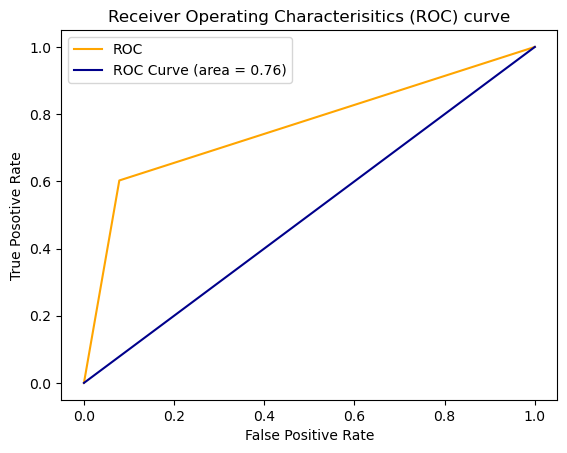

In [138]:
plt.plot(fpr,tpr, color = 'orange', label = "ROC")
plt.plot([0,1],[0,1], color = 'darkblue',label = 'ROC Curve (area = %0.2f)' %auc)
plt.xlabel('False Positive Rate')
plt.ylabel("True Posotive Rate")
plt.title("Receiver Operating Characterisitics (ROC) curve")
plt.legend()
plt.show()